# Breast Cancer Histopathological Image Classification (BreakHis) Dataset

The Breast Cancer Histopathological Image Classification (BreakHis) dataset consists of 9,109 microscopic photos of breast tumor tissue obtained from 82 individuals. These images were captured at various magnification factors, including 40X, 100X, 200X, and 400X.

## Image Characteristics

- **Resolution:** 700X460 pixels
- **Channels:** 3-channel RGB
- **Depth:** 8-bit depth per channel
- **Format:** PNG

## Dataset Composition

The dataset comprises a total of 7,909 images, with 5,429 samples classified as malignant and 2,480 samples classified as benign.

## Image Classification

- **Malignant Samples:** 5,429
- **Benign Samples:** 2,480

This dataset serves as a valuable resource for the development and evaluation of algorithms for the histopathological classification of breast tumor tissue.



## Importing the necessary libraries

In [1]:
import numpy as np
import pandas as pd

import os
for dirname, _, filenames in os.walk('D:\Mtech\Machine Learning\Project\BreaKHis_v1\BreaKHis_v1\histology_slides\breast'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

In [2]:
import shutil
import glob
import cv2
import random
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import seaborn as sns

In [3]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC
from sklearn.metrics import confusion_matrix, precision_score, recall_score, f1_score,accuracy_score
from sklearn.decomposition import PCA

## Reading the directory

In [4]:
def getListOfFiles(dirName):
    # create a list of file and sub directories 
    # names in the given directory 
    listOfFile = os.listdir(dirName)
    allFiles = list()
    # Iterate over all the entries
    for entry in listOfFile:
        # Create full path
        fullPath = os.path.join(dirName, entry)
        # If entry is a directory then get the list of files in this directory 
        if os.path.isdir(fullPath):
            allFiles = allFiles + getListOfFiles(fullPath)
        else:
            allFiles.append(fullPath)
                
    return allFiles

## Histogram equalization

In [5]:
def processing1(img_path):
    img = cv2.imread(img_path)
    if img is None:
        raise Exception(f"Error loading image: {img_path}")
    image = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    image = cv2.resize(image, (224,224))
    image = cv2.medianBlur(image, 5)
    
    image = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
    image[:, :, 2] = cv2.equalizeHist(image[:, :, 2])
    image = cv2.cvtColor(image, cv2.COLOR_HSV2RGB)
    cv2.imwrite(img_path,image)

## Convert to grayscale

In [6]:
def processing2(img_path):
    # Read the image from the provided file path
    img = cv2.imread(img_path)

    # Check if the image is successfully loaded
    if img is None:
        raise Exception(f"Error loading image: {img_path}")

    # Convert the image to grayscale
    gray_image = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Save the grayscale image back to the same file path
    cv2.imwrite(img_path, gray_image)


## Current working directory

In [7]:
pwd

'D:\\Mtech\\Machine Learning\\Project'

## Counting Number of Files in Benign and Malignant Directories

In [62]:
onlyfiles = next(os.walk('augmented/benign'))[2]
benign=len(onlyfiles)
print('Number of files in benign :',benign)
onlyfiles = next(os.walk('augmented/malignant'))[2]
malignant=len(onlyfiles)
print('Number of files in melignant :',malignant)
print('Total no of files in both benign and malignant is :',malignant+benign)

Number of files in benign : 2480
Number of files in melignant : 5429
Total no of files in both benign and malignant is : 7909


## Processing Images in the Benign Directory

In [9]:
benign=getListOfFiles('D:/Mtech/Machine Learning/Project/augmented/benign')
print(benign)
for f in benign:
    processing1(f) #Image Equalization

['D:/Mtech/Machine Learning/Project/augmented/benign\\SOB_B_A-14-22549AB-100-001.png', 'D:/Mtech/Machine Learning/Project/augmented/benign\\SOB_B_A-14-22549AB-100-002.png', 'D:/Mtech/Machine Learning/Project/augmented/benign\\SOB_B_A-14-22549AB-100-003.png', 'D:/Mtech/Machine Learning/Project/augmented/benign\\SOB_B_A-14-22549AB-100-004.png', 'D:/Mtech/Machine Learning/Project/augmented/benign\\SOB_B_A-14-22549AB-100-005.png', 'D:/Mtech/Machine Learning/Project/augmented/benign\\SOB_B_A-14-22549AB-100-006.png', 'D:/Mtech/Machine Learning/Project/augmented/benign\\SOB_B_A-14-22549AB-100-007.png', 'D:/Mtech/Machine Learning/Project/augmented/benign\\SOB_B_A-14-22549AB-100-008.png', 'D:/Mtech/Machine Learning/Project/augmented/benign\\SOB_B_A-14-22549AB-100-009.png', 'D:/Mtech/Machine Learning/Project/augmented/benign\\SOB_B_A-14-22549AB-100-010.png', 'D:/Mtech/Machine Learning/Project/augmented/benign\\SOB_B_A-14-22549AB-100-011.png', 'D:/Mtech/Machine Learning/Project/augmented/benign\\

In [10]:
benign=getListOfFiles('D:/Mtech/Machine Learning/Project/augmented/benign')
print(benign)
for f in benign:
    processing2(f) #Gray-scaling

['D:/Mtech/Machine Learning/Project/augmented/benign\\SOB_B_A-14-22549AB-100-001.png', 'D:/Mtech/Machine Learning/Project/augmented/benign\\SOB_B_A-14-22549AB-100-002.png', 'D:/Mtech/Machine Learning/Project/augmented/benign\\SOB_B_A-14-22549AB-100-003.png', 'D:/Mtech/Machine Learning/Project/augmented/benign\\SOB_B_A-14-22549AB-100-004.png', 'D:/Mtech/Machine Learning/Project/augmented/benign\\SOB_B_A-14-22549AB-100-005.png', 'D:/Mtech/Machine Learning/Project/augmented/benign\\SOB_B_A-14-22549AB-100-006.png', 'D:/Mtech/Machine Learning/Project/augmented/benign\\SOB_B_A-14-22549AB-100-007.png', 'D:/Mtech/Machine Learning/Project/augmented/benign\\SOB_B_A-14-22549AB-100-008.png', 'D:/Mtech/Machine Learning/Project/augmented/benign\\SOB_B_A-14-22549AB-100-009.png', 'D:/Mtech/Machine Learning/Project/augmented/benign\\SOB_B_A-14-22549AB-100-010.png', 'D:/Mtech/Machine Learning/Project/augmented/benign\\SOB_B_A-14-22549AB-100-011.png', 'D:/Mtech/Machine Learning/Project/augmented/benign\\

## Processing Images in the Malignant Directory

In [11]:
malignant=getListOfFiles('D:/Mtech/Machine Learning/Project/augmented/malignant')
for f in malignant:
    f = processing1(f)#Image Equalization

In [12]:
malignant=getListOfFiles('D:/Mtech/Machine Learning/Project/augmented/malignant')
for f in malignant:
    f = processing2(f)#Gray-scaling

## Displaying Images with Labels in a Grid

In [13]:
# Function to display some images with labels
def display_images_with_labels(directory, label, num_images=4):
    files = getListOfFiles(directory)
    selected_files = random.sample(files, num_images)
    
    plt.figure(figsize=(10, 8))
    
    for i, file_path in enumerate(selected_files, 1):
        img = cv2.imread(file_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        
        plt.subplot(2, 2, i)
        plt.imshow(img)
        plt.title(f"{label} Image {i}")
        plt.axis('off')
    
    plt.show()

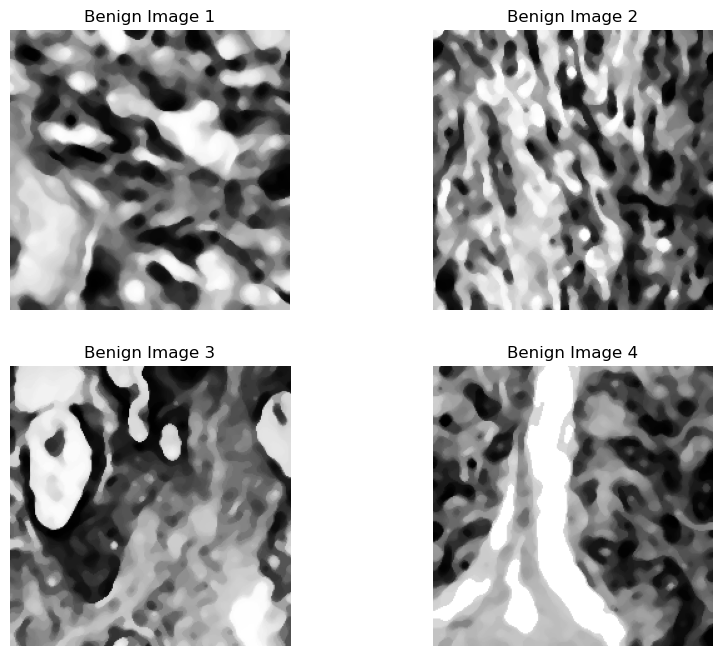

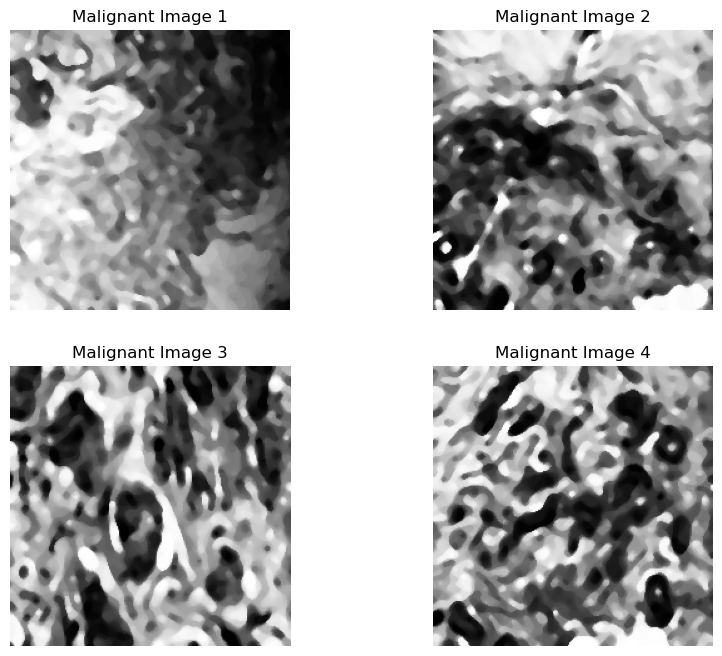

In [14]:
# Display 4 images (2x2) for both benign and malignant
display_images_with_labels('D:/Mtech/Machine Learning/Project/augmented/benign', label='Benign', num_images=4)
display_images_with_labels('D:/Mtech/Machine Learning/Project/augmented/malignant', label='Malignant', num_images=4)

In [15]:
benign

['D:/Mtech/Machine Learning/Project/augmented/benign\\SOB_B_A-14-22549AB-100-001.png',
 'D:/Mtech/Machine Learning/Project/augmented/benign\\SOB_B_A-14-22549AB-100-002.png',
 'D:/Mtech/Machine Learning/Project/augmented/benign\\SOB_B_A-14-22549AB-100-003.png',
 'D:/Mtech/Machine Learning/Project/augmented/benign\\SOB_B_A-14-22549AB-100-004.png',
 'D:/Mtech/Machine Learning/Project/augmented/benign\\SOB_B_A-14-22549AB-100-005.png',
 'D:/Mtech/Machine Learning/Project/augmented/benign\\SOB_B_A-14-22549AB-100-006.png',
 'D:/Mtech/Machine Learning/Project/augmented/benign\\SOB_B_A-14-22549AB-100-007.png',
 'D:/Mtech/Machine Learning/Project/augmented/benign\\SOB_B_A-14-22549AB-100-008.png',
 'D:/Mtech/Machine Learning/Project/augmented/benign\\SOB_B_A-14-22549AB-100-009.png',
 'D:/Mtech/Machine Learning/Project/augmented/benign\\SOB_B_A-14-22549AB-100-010.png',
 'D:/Mtech/Machine Learning/Project/augmented/benign\\SOB_B_A-14-22549AB-100-011.png',
 'D:/Mtech/Machine Learning/Project/augment

In [16]:
malignant

['D:/Mtech/Machine Learning/Project/augmented/malignant\\SOB_M_DC-14-10926-100-001.png',
 'D:/Mtech/Machine Learning/Project/augmented/malignant\\SOB_M_DC-14-10926-100-002.png',
 'D:/Mtech/Machine Learning/Project/augmented/malignant\\SOB_M_DC-14-10926-100-003.png',
 'D:/Mtech/Machine Learning/Project/augmented/malignant\\SOB_M_DC-14-10926-100-004.png',
 'D:/Mtech/Machine Learning/Project/augmented/malignant\\SOB_M_DC-14-10926-100-005.png',
 'D:/Mtech/Machine Learning/Project/augmented/malignant\\SOB_M_DC-14-10926-100-006.png',
 'D:/Mtech/Machine Learning/Project/augmented/malignant\\SOB_M_DC-14-10926-100-007.png',
 'D:/Mtech/Machine Learning/Project/augmented/malignant\\SOB_M_DC-14-10926-100-008.png',
 'D:/Mtech/Machine Learning/Project/augmented/malignant\\SOB_M_DC-14-10926-100-009.png',
 'D:/Mtech/Machine Learning/Project/augmented/malignant\\SOB_M_DC-14-10926-100-010.png',
 'D:/Mtech/Machine Learning/Project/augmented/malignant\\SOB_M_DC-14-10926-200-001.png',
 'D:/Mtech/Machine Le

## Flattening Images

In [17]:
# Function to flatten the images
def flatten_images(images):
    return images.reshape(images.shape[0], -1)

## Loading Images as Arrays

In [18]:
def load_images_as_arrays(directory):
    files = getListOfFiles(directory)
    images = []

    for file_path in files:
        img = cv2.imread(file_path, cv2.IMREAD_GRAYSCALE)  # Read image as grayscale
        if img is not None:
            # Resize the image if needed
            img = cv2.resize(img, (224, 224))
            images.append(img)
    return np.array(images)



In [19]:
#Load images as arrays for both benign and malignant
benign_images = load_images_as_arrays('D:/Mtech/Machine Learning/Project/augmented/benign')
malignant_images = load_images_as_arrays('D:/Mtech/Machine Learning/Project/augmented/malignant')

## Shape of Array

In [20]:
# Display the shapes of the arrays
print(f"Benign Images Shape: {benign_images.shape}")
print(f"Malignant Images Shape: {malignant_images.shape}")


Benign Images Shape: (2480, 224, 224)
Malignant Images Shape: (5429, 224, 224)


In [56]:
benign_images[0].shape

(224, 224)

In [58]:
for i in range(224):
    for j in range(224):
        print(benign_images[i][j])

[115 115 118 118 130 130 133 134 139 146 146 146 146 146 127 127 127 127
 127 127 127 127 127 123 110  94  94  94  94  94  94  94  96  96  96  96
  96  96  96  96  96  96  96 100 100 100  99  89  89  68  68  59  59  68
  68  89 144 147 147 144 133  63  52  51  51  52  63  65  99  99  99  97
  76  57  57  50  50  50  50  50  63  78  82  99  99  99  99 118 136 136
 136 136 136 136 136 136 136 112 112 112 112 112 118 133 133 133 133 133
 133 127 118  39  32  32  32  32  32  32  32  32  32  27  26  26  26  26
  26  26  26  22  19  19  18  18  18  19  22  33  39  53  56  68  82  92
  99  99  99  99  99  99  99  99  94  89  74  74  74  74  74  56  56  56
  56  56  56  56  56  56  56  57  59  59  59  59  59  48  41  41  41  41
  39  39  39  39  39  39  39  74  74  74  74  74  57  57  57  57  57  57
  57  57  71  71  57  56  56  56  56  56  56  57  72  72  72  72  72  72
  72  72  72  71  71  71  56  56]
[115 115 118 118 130 133 134 139 146 146 146 146 146 146 127 127 127 127
 127 127 127 127 

[247 247 247 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245
 245 245 245 245 245 245 238 238 232 228 225 223 221 219 213 175 173 153
 153 153 156 159 216 217 217 217 156  20  11   1   1   1   6  11  15  18
  20  26  34  57 185 223 252 253 253 253 253 253 253 253 253 253 250 250
 238 227 221 213 170 103  80  97 101 103 126 126 139 143 147 147 147 147
 126 126 106 105 105 106 106 126 147 152 155 170 170 171 171 171 170 147
 120 120 120 120 120 120 114 120 120 123 128 139 159 177 191 192 195 195
 195 195 193 189 177 109  83  83  83  83  75  75  75  75  75  75 136 139
 139 139 143 143 143 143 155 191 198 199 202 204 204 204 204 204 204 202
 197 192 183 155 155 143 136 136 129 136 136 159 159 162 175 179 179 187
 187 187 187 187 187 185 181 152 152 147 147 152 152 155 159 159 156 155
 132 110  64  64  64  64  64  64 166 166 166 166 164 143 120 120 114 114
 114 114 114 128 187 213 213 213]
[247 247 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245
 245 245 245 245 

[142 143 150 153 153 153 153 153 156 164 168 177 177 177 177 177 184 195
 201 206 206 206 206 206 201 198 195 187 182 182 182 182 182 182 182 184
 184 184 188 195 198 198 200 200 200 200 200 198 195 195 195 195 198 198
 198 203 204 204 206 206 206 198 195 193 191 187 187 187 187 187 187 191
 193 193 195 198 193 191 191 191 182 170 168 167 167 167 168 168 168 168
 168 168 168 170 170 170 178 170 168 168 168 168 168 159 159 158 158 158
 153 151 153 158 158 159 162 162 162 162 162 162 161 150 150 150 150 151
 154 179 182 198 198 198 198 198 198 184 182 168 168 165 154 135 122 117
 110 110 110 110 106  98  83  53  51  51  51  56  61  67  69  69  69 102
 134 150 156 156 156 156 156 154 117  79  30  19  10   8   6   6   6   8
 236 251 254 254 255 255 255 255 255 255 254 252 247 247 242 230 226 215
 215 215 220 226 226 233 236 238 238 241 241 241 241 244 248 251 251 251
 251 251 249 248 247 244 242 242]
[134 137 146 153 153 153 153 153 161 161 165 173 177 177 177 182 188 195
 203 206 206 206 

[238 238 238 238 238 238 238 238 238 236 226  60  50  50  45  43  43  43
  43  43  43  44  48 169 210 210 210 210 210 204 199 199 199 169 121 121
 121 121 133 156 162 175 179 183 192 197 201 210 210 206 204 195 195 195
 195 195 195 199 208 221 224 226 226 226 224 222 216 206 179 157  90  71
  62  62  60  62  62  62  69  74  84  93 100 100 100 100 106 115 159 162
 169 169 164 154 154 143 135 135 135 135 135 133 104 100  82  76  71  62
  62  57  46  40  28  14   8   1   1   1   1   1   1   1   1   1   1   1
   2   2   3   5   5   6   6   9   9  14  19  39  48  69  76  84  93  95
 108 119 144 161 161 180 186 192 199 199 199 199 199 199 144 141 108 106
 104  95  95  95  95  95  95  95  95  95  96  98 114 144 183 189 194 195
 195 195 195 199 199 199 195 195 183 119  85  55  48  39  39  48  50  55
  56  62  87  90  96  96  90  62  51  49  49  49  49  51  64 125 197 197
 197 197  44  44  43  44  44  45]
[238 238 238 238 238 238 238 238 238 236 222  60  50  50  45  43  43  43
  43  43  43  44 

[ 12  12  12  14  14  45 208 209 209 209 209 209 209 209 209 209 209 209
 201 200 200 200 197 182 166 129 129 121 121 100  90  66  66  66  66 174
 174 174 174  35  28  28  24  28  28  35  44  68  76  81  84  88  88  87
  81  78  53  37  37  37  40 113 115 115 113 108  78  76  76  76  76  76
  76  76  56  37  37  37  37  37  92 213 214 215 215 215 215 215 215 215
 215 215 214 211 123  24  23  21  19  17  17  17  20  32  70 111 126 128
 128 132 128 128 117 105 104 101  96  92  87  87  70  64  39  39  39  39
  35  35  35  35  35  37  37  37  37  37  37  37  35  28  28  28  28  26
  26  26  26  26  26  26  28  35  58  58  58  61  64  76  78  82  96  97
 113 128 128 128 128 128 128 115 113 113  97  96  95  76  62  62  62  62
  62  61  62  62  81  81  81  81  81  81  81  66  66  51  51  51  51  51
  51  51  51  51  51  51  35  28  26  26  26  26  26  26  26  26  28  29
  35  35  29  28  23  21  21  19]
[ 12  12  12  14  21 207 209 209 209 209 209 209 209 209 209 209 209 204
 201 200 200 200 

[189 189 189 189 189 189 189 189 189 189 189 189 189 189 189 189 189 189
 189 199 199 199 199 213 213 213 213 213 213 213 202 189 189 189 171 151
 123   2   2   2   2   8  43  51  53  57  62  62  62  62  62  62  62  62
  68  69  76  79  84  89  89  86  84  79  71  67  35  31  31  31  35  41
  48  48  48  48  48  48  49  53  53  53  53  53  53  53  53  53  53  73
 102 135 135 135 135 135  89  81  79  79  79  79  84  91  91  91  89  57
  53  43  38  26  24  24  24  76 123 199 202 202 202 202 213 213 213 213
 213 232 232 232 232 232 232 232 232 232 232 232 232 232 232 232 232 232
 232 232 232 232 232 232 232 213 213 213 213 213 213 213 202 202 202 202
 202 202 202 202 202 202 202 199 199 199 189 189 189 189 189 189 189 189
 189 189 189 189 189 189 189 189 189 189 189 189 189 189 189 171 171 171
 171 171 171 171 171 171 154 154 154 154 154 151 151 151 151 151 151 151
 151 151 151 151 151 125 123 118]
[189 189 189 189 189 189 189 189 189 189 189 189 189 189 189 189 189 189
 189 189 199 199 

[122 124 124 151 152 152 152 152 151 148 146 146 146 146 148 152 152 153
 153 160 160 153 153 149 129 122 122 122 121 121 118 118 118 121 122 122
 135 151 151 151 151 151 140 138 138 138 140 140 140 140 140 140  98  88
  88  86  84  78  78  78  78  78  78  78  78  66  62  62  62  60  58  56
  53  53  53  53  53  50  50  49  49  42  38  38  38  38  38  38  38  38
  38  38  37  35  35  34  34  34  34  34  34  34  34  30  26  23  22  15
  15  24  27  34  56  97 164 197 209 218 226 238 241 241 241 241 241 241
 241 242 242 242 241 241 236 226 220 218 214 206 206 206 206 201 197 175
 153 128 128 128 188 201 220 236 236 236 236 236 236 232 226 218 183 136
  73  35  20  13  13  13  13  17  37  40  40  40  43  47  50  56  57  64
  73  86 122 151 183 194 194 194 192 192 160 138 122 113  99  95  95  95
  95 112 151 197 197 210 210 206 197 197 170 107  90  76  60  58  58  56
  56  56  56  53  49  49  49  49]
[121 122 124 146 151 152 152 151 151 146 146 146 146 146 146 152 152 152
 152 152 152 151 

[ 95  95  95  95  96 101 132 141 141 141 141 134 120 119 102  73  73  73
  78  82  95 101 101 101 101 101  95  82  65  27  21  12  12  12  12  12
  12  12  12  12  12  11   9   8   7   7   3   0   0   0   0   0   0   0
  57 211 226 233 233 237 237 237 237 237 237 237 237 237 237 237 245 245
 245 245 245 245 245 245 245 245 239 239 233 228 228 228 228 228 226 216
 215 215 215 215 221 233 239 246 253 253 253 253 253 253 253 253 253 253
 253 253 253 253 253 253 253 253 247 246 246 246 246 239 234 211 196 128
 125 120 114 113 113 113 113 113 113 113 110 114 117 122 123 123 135 144
 161 176 201 211 216 218 218 221 221 221 221 221 221 221 221 221 221 221
 221 221 221 221 221 221 221 218 218 216 215 208 201 195 192 190 183 183
 172 154 154 155 168 168 172 172 172 172 171 171 171 171 171 171 177 201
 208 211 211 215 215 215 215 215 215 215 215 215 215 215 215 215 211 211
 211 208 206 203 177 161 146 132]
[ 96  96  96 101 101 132 141 141 141 141 129 120 119 102  99  66  66  73
  73  93 101 101 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[ 55  61  74  74  74  81  89  93 125 142 159 173 180 189 189 189 189 189
 189 189 190 190 190 184 180 180 168 168 168 168 168 168 168 170 170 168
 157 151 142 138 138 145 166 166 166 166 166 164  99  69  69  69  69  69
  70  70  70  70  70  70  70  70  70 101 184 184 184 184 170 138 137 135
 135  97  97  97  97  97  97  97 103 135 135 135 112 112 112 112 112 106
  89  84  74  70  70  99 164 173 199 198 198 194 175 121  89  84  84  64
  64  19  18  19  19  19  27 215 222 227 229 232 232 232 232 232 232 232
 236 236 236 237 237 237 237 237 237 236 236 232 232 232 227 222 218 208
 203 184 184 162 159 159 151 130 130 130 127 127 127 125 127 170 170 170
 157 157 149 116  84  84  84  84  84  84  89 112 121 121 121 121 121 121
 121  92  92  89  89  89  92  92  89  89  89  84  42  42  42  42  55  61
  61  61  61  61  61  55  51  36  36  36  51  51  51  51  51  51  51  51
  42  42  42  42  42  42  42  42]
[ 74  74  74  74  77  89  93 106 125 142 145 171 180 184 189 189 189 189
 189 190 190 190 

[239 239 239 239 239 239 239 239 239 239 239 239 239 246 250 250 250 250
 250 250 250 246 246 246 239 228 214 203 194 182 155 155 140 153 153 153
 153 153 153 139  75  42  27  24  20  20  24  65 219 221 221 221 221 221
 221 221 221 222 223 224 224 224 222 221 212 211 211 211 228 230 230 230
 230 223 146  40  16  15  15  15  16  20  22  33  39  43  45  46  46  48
  59  63  63  63  63  63  59  39  30   8   7   6   6   7   7   7   8  10
  13  13  13  13  13  15  15  15  15  20  20  23  23  26  26  30  35  46
  70  81  81  81  81  70  70  70  70  70  70  63  63  63  63  63 173 181
 181 182 182 183 183 183 183 181 179 165 163 163 135 122 122 122 122 129
 153 153 153 153 153 142 142 142 142 142 142 142 142 146 146 146  46  46
  45  37  34  34  28  27  27  27  27  34  36  42  44  51  53  59  74 111
 111 111 111 111 148 191 191 177 177 165 163 142 142 142 142 142 142 142
 139 139 135 121 121 121 121 121]
[239 239 239 239 239 239 239 239 239 239 239 246 250 250 250 250 250 250
 250 250 250 250 

[156 156 169 174 182 182 174 147 138 129 129 128 118 114 102  77  65  41
  30  30  30  30  30  30  39  41  58  81  94 124 142 150 150 150 156 161
 170 173 173 173 173 173 173 173 173 173 173 173 173 156 144 124 124 122
 111 110  96  53  40  29  19  15  11  10   8   8   6   4   6   6   6   6
   6   4   1   1   0   0   0   0   0   0   1   1   1   3   3   3   3   4
   4   4   4  10  12  19  32  32  39  39  44  51  54  77  89  89  92  92
  92  92  92  92  92  89  89  89  77  77  68  65  53  46  46  46  46  46
  46  47  62  73  73  73  46  46  46  47  49  57  68  80  89  89  89  92
 107 107 154 154 154 154 138 107  99  99  99 102 131 154 184 193 199 204
 208 214 217 217 220 220 220 223 223 223 223 223 223 223 223 220 220 218
 216 216 214 212 210 197 184 154 150 142 117 117 117 138 139 139 139 141
 141 141 141 142 150 154 154 150 150 142 129 128 127 127 128 163 166 176
 176 176 176  70  43  43  39  39]
[144 156 169 173 174 174 173 159 146 131 129 129 128 115 102  65  61  40
  30  30  30  30 

[152 151 151 151 149 144 137 137 137 137 137 137 139 139 139 139 139 130
 125 121 113 113 113 113 115 121 121 121 121 121 121 117  98  86  63  59
  53  48  46  46  45  45  45  37  36  28  28  36 108 202 213 217 223 230
 230 230 230 230 230 230 230 240 240 240 240 251 251 251 251 251 255 255
 255 255 255 255 255 255 255 251 251 251 251 251 243 217 213 203 197 196
 196 196 196 196 196 197 197 200 206 208 211 213 213 213 213 186  46  28
  19  14   9   9   9   9   9  17  28 175 180 180 180 180 180 171 147  81
  81  81  81  81  90 154 164 167 171 171 171 178 180 180 178 173 173 173
 184 187 187 187 175 171 164 164 160 160 158 149  81  76  76  76  76  70
  36  36  36  36  36  36  39  53  67 156 185 192 192 196 197 197 196 196
 194 192 184 171 137  79  71  67  67  76 190 197 197 197 197 197 197 197
 196 196 193 190 164  76  39  36  36  36  36  37  45  50  55  55  60 147
 147 147 106  74  60  60  60  60]
[151 151 151 151 145 144 137 137 137 137 137 137 139 139 139 139 130 129
 121 118 113 113 

[ 46  31  21  21  21  38 102 110 125 171 194 194 194 191 147 147 147 155
 158 171 173 178 171 171 169 166 158 155 155 154 154 155 156 156 173 178
 188 188 189 191 191 189 189 189 178 151 122  95  67  51  51  51  68 120
 154 154 155 171 171 158 155 154 154 153 153 158 185 213 221 222 227 227
 227 227 227 210 191 158 158 158 160 161 163 163 163 161 158 136 133 131
 130  93  54  54  64  93  93  99 102 122 122 125 125 126 155 180 185 207
 207 209 212 213 213 212 212 212 212 214 219 230 231 237 237 237 240 240
 240 238 235 230 221 143  86  41  36  26  26  20  20  20  20  20  20  20
  20  20  20  20  20  20  15  14  10  10  10  10  10  12  59  62 191 211
 211 211 211 198 178 146 115  38  10  10  10  10  10  14  21  31  31  46
  46  48  48  48  48  48  48  48  48  48  49  49  49  51  51  51  59  60
  62  62  62  86  91 115 167 178 198 167 115  89  17   1   1   1   1   1
   2   4   5   7   7   7   7   7]
[ 21  14  14  14  14  14  33 102 110 158 194 194 194 194 147 147 147 155
 158 178 178 178 

[ 53  53  53  53  53  53  53  53  53  53  53  53  53 101 115 115 201 201
 201 204 244 244 245 255 255 245 245 245 244 244 240 204 201 119 101  52
  36  19  11  11  11  19  25  25  36  44  90 101 156 173 173 173 173 190
 190 190 190 190 190 190 190 190 190 190 190 190 190 190 190 173 173 173
 173 173 190 190 190 190 190 201 201 201 201 226 240 240 240 240 240 240
 240 240 240 240 240 240 240 249 249 249 249 240 240 240 240 240 240 240
 240 240 240 240 240 240 240 240 240 244 244 244 244 244 244 244 240 240
 226 226 226 201 201 201 201 201 190 190 190 190 190 190 190 190 190 190
 190 173 101 101 101 101 156 173 173 173 173 173 173 173 173 173 173 173
 173 173 190 190 190 201 229 229 201 190 190 190 173 173 173 173 173 101
 101 101 101 101 101 115 115 115 115 115 115 190 190 190 190 190 190 190
 190 190 190 190 190 190 190 190 190 190 190 190 190 190 190 190  90  25
  25  25  15  15  15  15  15  15]
[ 53  53  53  53  53  53  53  53  53  53  53  53 101 115 115 190 201 201
 201 204 204 244 

[143 138 120 110 110  98  98  98  90  81  79  75  74  74  69  67  67  63
  63  67  69  71  79  98 108 120 132 132 132 146 191 210 210 210 210 210
 194 176 110  98  83  80  79  74  60  60  60  60  60  63  73  79  84  84
  95 111 123 134 134 123 106  70  64  64  64  64  64  69  84 101 132 132
 132 101  57  51  50  50  51 203 203 203 203 195 152  46  46  46  46  59
  74  79  79  79  79  79  79  79  96 177 212 233 236 246 246 246 246 246
 223  80  51  49  49  49  47  46  43  32  18  15  11  11  11  11  11  11
  11  10  10  11  11  16  18  25  32  46 152 158 162 158 156 156 156 132
 132 132 132 132 132 132 132 132 132 132 132 134 134 134 134 134 141 143
 143 143 146 146 162 162 162 173 176 176 176 176 176 173 162 162 162 162
 146 146 134 134 134 134 134 134 134 134 134 134 134 134 134 132 132 132
 132 132 141 146 148 156 158 158 158 158 158 158 158 132 132 132 132 118
 116 106 106 106 106 106 106 106]
[138 127 120 110 110  98  98  96  87  81  79  79  75  74  74  69  69  67
  67  69  70  74 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[232 232 229 228 226 226 226 226 226 223 221 211  40  12  12   6   6   6
   7  12  13  15  15  17  17  23  31  32  33  33  33  33  33  33  33  33
  41  47  47  47  47  47  38  38  38  38  41  44  44  44  44  44  44  73
 136 164 164 164 164 164 170 211 211 211 211 211 211 183 115 110 110 110
 110 110 114 138 166 169 169 168 159 159 158 158 158 158 158 155 144 124
 117 104 104 104 104 110 132 132 132 132 144 153 164 164 142 139 117 104
 104 104 104 104 118 134 166 172 175 175 175 175 173 172 169 169 168 168
 161 158 142 122 114 102  96  96  96  96 188 195 195 195 195 197 195 190
 178 165 147 147 140 138 136 136 131 126 121 121 120 120 120 126 128 146
 149 153 149 147 118 114 110 108  89  62  54  47  47  47  59  75  80  98
 101 107 120 120 120 120 120 120 124 124 124 124 124 124 180 192 195 195
 192 192 138 114  79  49  27  22  21  13   7   7   7   7   7   7   7   7
  23  42  69 114 114 128 128 128]
[232 232 229 228 226 226 226 226 226 226 221 215 172  12  12  12   6   7
  12  12  12  13 

[212 212 212 119 110 110 110 110 110 119 158 158 158 158 158 203 215 224
 225 226 226 226 226 226 225 222 216 208 178 162 143  94  94  94  94  94
 110 136 143 162 147 143 136 119  82  82  82  82  82  90  94 110 110 136
 143 147 162 162 162 147 143 143 143 143 143 143 124 119 119 119 110 110
 110 110  90  90  90 110 110 110 110 110 110 110  90  90  82  82  67  67
  67  67  67  77  77  77  77  77  77  67  57  57  51  51  51  57  57  57
  57  57  57  57  55  47  47  47  45  35  35  30  30  30  33  40  40  40
  40  40  40  40  35  35  35  33  33  23  23  16  12  12  10  10   6  10
  10  10  10  10  10  10  10  10  10  10  12  16  16  20  23  23  23  24
  24  24  23  20  20  20  20  20  20  20  20  24  24  26  26  28  28  28
  28  24  24  23  20  16  13  13  13  13  13  16  16  23  28  28  28  28
  28  28  28  33  33  33  33  33  33  26  24  24  24  24  24  24  24  24
  24  24  24  24  24  23  23  23]
[212 119 119 110 110 110 110 119 158 158 158 158 158 158 158 162 208 220
 224 226 226 226 

[252 229 214 175 148  35  25  15  12  12  12  12  12  15  25  30  35  44
  46  48  55  55  55  57  89 107 107 107 112 112 130 130 130 130 130 130
 187 237 240 240 240 240 240 231 214 195 195 195 195 195 195 195 195 195
 195 200 204 204 195 195 175 164 164 164 151 148 148 134 130 130 130 134
 134 151 156 164 164 164 164 164 156 148 140 107 107 107 130 130 130 140
 148 151 156 156 164 164 164 164 164 169 175 175 182 182 182 182 182 175
 156 130 107  97  97  97  97 118 134 148 156 164 164 164 167 182 209 209
 209 214 217 217 217 221 221 221 221 221 214 209 209 195 195 195 191 191
 195 195 195 209 209 221 224 227 227 227 227 221 217 214 214 209 209 209
 209 209 204 204 204 204 209 209 217 221 222 224 227 229 231 231 229 227
 227 224 222 222 222 222 222 222 222 224 224 229 229 229 227 224 224 217
 217 214 211 211 210 210 210 210 209 209 209 209 204 204 204 209 209 209
 209 209 209 209 209 200 191 184]
[253 252 247 214 175  55  25  25  15  12  12  12  12  15  25  30  35  44
  46  48  55  55 

[  9  11  11  11  15  15  15  15  15  15  21  24  32  32  32  40  47  47
  47  47  47  53  63  63  63  63  63  63  63  63  63  63  63  72  72  79
  89  89 102 102 102 102 102 102 102 102 102 102 119 119 119 119 119 119
 119 119 119 102 102  89  89  89  89  89  89  89 119 119 135 135 135 139
 150 150 150 150 150 150 155 155 163 163 163 163 163 155 155 150 139 139
 135 135 135 139 150 155 155 155 155 155 155 163 163 163 163 163 166 170
 170 174 174 170 170 170 170 170 163 163 163 163 163 163 170 174 186 191
 191 191 186 177 163 163 163 163 177 187 222 241 242 242 242 218 166 106
 104 104 104 102  93  89  93 102 104 106 106 106 106 106 119 121 135 135
 135 135 135 121 121 104 104 104 104 150 150 163 163 163 150 150 121 121
 121 121 121 135 163 180 189 222 226 226 226 222 199 197 197 195 193 187
 186 186 163 121 119 119 119 119 119 119 119 119 119 119 119 119 119 119
 123 139 186 233 235 235 235 235]
[  9  11  11  11  15  15  15  15  15  15  15  24  24  32  32  32  47  47
  47  47  47  47 

[  9   9   9   9   9   9   9   9   9   9   4   1   1   1   1   1   1   1
   1   2   4  11  17  17  17  17  17  17  17  17  17  17  19  22  28  28
  28  28  30  35  35  40  48  56  91 114 116 121 127 127 121 121 120 119
 119 113 112 112 112 112 112 112 112 119 139 156 157 157 156 145 137 129
 124 116 115 106  77  35  35  35  33  33  32  32  32  32  58 158 205 207
 207 207 207 207 207 207 205 201 199 193 192 188 165  44  44  44  44  44
  51  55  55  60  65  65  65  65  69  69  77  77  77  77  77  77  79  79
  79  81  79  79  69  65  63  56  42  26  26  26  26  38  40  51  63  76
  88 106 117 148 152 152 152 148 115 107  97  97  97 127 140 141 142 142
 142 157 168 168 168 116 106  95  95  95  95  95  95  95  95  95  95  95
  97  97  97  97 107 119 163 200 203 207 207 210 210 210 210 210 210 210
 210 210 210 212 212 213 213 214 214 214 214 217 217 217 217 217 219 219
 219 219 219 217 215 215 215 214]
[  4   9   9   9   9   9   9   9   9   9   4   2   1   1   1   1   1   1
   1   2   4   9 

[203 203 201 201 201 201 201 201 201 201 210 215 230 233 236 236 236 236
 236 234 233 229 229 224 223 223 221 221 218 218 217 217 212 208 205 205
 205 205 205 247 249 250 253 253 253 252 249 244 244 194 194 194 244 245
 245 196  43   4   4   4   6   8  11  35  98 129 218 250 250 250 250 250
 250 250 252 252 252 253 253 253 253 252 252 174  77  77  77  77  94 127
 127 128 139 157 163 165 172 176 179 179 179 195 203 208 209 215 233 224
 220 215 213 212 213 213 220 229 237 240 240 244 245 245 245 245 245 245
 244 244 242 240 240 239 239 237 234 234 231 230 229 227 223 218 218 218
 218 218 218 218 218 218 221 226 231 234 237 244 244 244 244 244 231 191
 100  80  71  71  71  71  71  71  72  88 102 102 134 141 143 143 143 143
 139 136 129 119 112  98  98  98  98 110 110 119 162 162 162 162 153 141
 129 122 102 100 100 100 100 100  98  98  94  86  86  86  86  86 118 158
 158 158 158 158 145 143 126 126]
[203 203 203 201 201 201 201 201 201 206 213 224 231 234 236 236 236 236
 236 234 230 229 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[211 211 210 208 207 204 192 190 183 182 180 176 176 176 176 176 180 190
 194 197 197 197 200 204 212 218 224 224 226 226 226 226 226 224 214 174
 142 142 106  90  90  90 116 187 192 194 197 197 194 192 178 163 159 158
 158 158 158 163 165 174 177 178 178 178 178 178 177 176 176 176 176 177
 177 178 178 178 178 178 176 176 176 176 176 176 176 184 192 192 192 192
 192 190 187 187 184 174 163 163 163 160 154 153 153 136 117  97  78  58
  57  57  57  57  57  57  57  63  85 105 128 128 148 148 127 127 106 106
 106 106 108 108 111 128 130 130 128 128  92  68  50  39  39  31  31  31
  31  27  27  27  27  27  23  22  19  19  19  18  18  18  15  12  10   9
   9   9   9   7   7   7   7   7   7   7   5   5   7   9  70 133 174 229
 239 243 244 244 246 248 248 249 250 250 251 251 250 250 249 248 246 236
 172 151 130 128 105  72  54  54  53  68  68 235 239 239 243 246 246 246
 246 246 242 240 239 236 235 235]
[211 208 208 207 204 200 190 187 182 180 180 180 176 176 176 178 180 190
 194 197 197 197 

[164 164 164 164 164 164 164 172 197 208 239 240 240 240 240 240 240 242
 242 242 243 243 243 243 244 244 247 247 247 248 248 248 248 248 248 250
 251 251 250 248 248 248 248 248 248 248 248 247 243 240 239 232 230 214
 206 187 156 134 134 134 134 156 161 171 206 228 233 239 242 248 251 251
 251 251 250 248 244 240 239 235 232 228 220 208 197 192 161 156 156 134
 134 156 156 161 161 161 161 161 161 161 161 171 171 171 161 137 121 101
  82  68  49  41  38  38  38  38  31  25  22  20  18  18  17  17  15  13
  13  13  15  15  15  17  18  25  31  82 150 223 223 223 223 214 187 121
 121 121 121 116 116 116 116 116 116 116 126 126 126  97  41  26  26  26
  26  26  26  25  25  25  25  25  25  30  30  30  30  30  30  30  43  44
  55  57  68  87  87  87 116 121 121 121 121  55  55  55  55 189 224 224
 224 216 197  87  87  87  72  72  72  57  55  44  43  43  35  35  35  35
  30  30  25  25  25  25  25  25]
[164 164 164 164 164 164 164 164 164 172 180 180 180 142 142 142 145 235
 239 242 242 243 

[ 69  69  67  67  64  62  52  37  26  22  16   5   2   2   2   1   1   1
   1   2  31 142 150 156 162 169 183 196 200 200 200 200 200 200 200 200
 200 200 200 201 208 208 208 208 208 208 208 208 208 208 208 208 210 210
 208 208 208 208 200 196 196 196 196 200 208 220 220 228 228 228 228 228
 228 228 228 228 228 228 247 252 252 252 252 252 252 252 252 252 247 200
 162 156 153 145 143 143 145 149 151 156 162 169 196 208 220 220 220 220
 220 208 208 208 208 208 208 200 196 185 183 169 169 169 169 169 162 162
 162 156 153 150 149 145 142 140 134 118 113 108  98  53  22   7   7   5
   7   7   9   9  12  12  12  12  12  14  18  21  28  31  31  31  31  27
  26  24  24  24  24  26  28  33  42  46  48  48  48  48  48  48  53  61
  67  79  90  96  98  98  96  64  64  64  64  92 105 105 105 100  71  61
  59  59  61  73  88 103 113 120 126 126 126 126 125 120 113  94  79  61
  54  48  42  40  40  44  44  59]
[ 67  67  64  64  62  62  42  37  27  26  19  10   4   2   2   2   2   2
   2   9  99 149 

[ 14  14  14  14  14  14  16  16  18  22  32  56  72  80  86  86  86  86
  86  82  81  81  81  80  79  79  79  81  86  96  96  99  99 103 118 121
 129 121 118  99  92  78  66  56  49  47  47  46  46  49  64  92  96 138
 160 169 172 174 181 184 176 167 121 105  88  79  63  38  24  22  18  16
  12  12  12  16  16  16  16  16  13  10  10  10  10  13  13  13  13  14
  14  16  16  19  54  54  54  54  54  46  38  38  46  49  52  69  81  88
  99 101 121 157 210 227 228 231 233 233 233 233 233 231 228 227 206 180
 180 180 180 184 189 189 191 191 189 189 160 140 137 137 137 137 137 137
 137 146 146 146 146 146 144 126 125 118 100 100 100 105 110 110 110 100
  94  68  25  22  22  22  22  22  24  42 130 157 174 177 187 191 191 193
 197 202 204 204 206 206 208 208 208 208 208 208 209 209 209 209 209 209
 209 209 208 204 198 198 198 198 198 198 198 198 198 196 191 181 176 171
 166 166 166 166 165 163 144 144]
[ 14  14  14  14  14  14  14  16  16  20  32  56  72  86  86  86  86  86
  86  82  81  81 

[ 12  15  15  15  19  19  21  21  21  21  21  21  21  21  21  17  15  14
  12  11  11  12  12  19  27  60  94 116 152 154 171 189 189 177 154 154
 128  52  52  52  52  52  52  53  71  89 111 115 116 116 131 136 136 136
 138 191 230 238 242 242 242 242 242 242 242 241 240 240 240 242 242 245
 249 249 249 249 247 247 246 246 245 234 208 191 187 184 180 177 171 177
 179 194 194 194 194 212 212 217 219 219 219 219 219 219 219 215 212 206
 194 157 132 132 131 131 131 131 128 128 116 112 111 109 109 108  89  89
  88  71  71  71  71  70  70  70  69  69  69  69  71  78  78  78  78  75
  64  64  60  60  60  60  60  60  60  78  78  78  78  78  60  60  45  35
  35  25  19  17  17  17  17  17  17  17  25  45  51  51  51  51  51  45
  45  35  31  25  25  31  35  64  80 101 104 104 104 104 104 138 138 138
 132 120 116 115 115 115 115 131 131 132 157 208 208 208 208 160  67  51
  51  36  35  35  35  35  35  35]
[  9  12  15  15  17  19  21  21  21  21  21  21  21  21  17  15  14  12
  11  11  11  12 

[108 108 125 126 131 146 148 160 164 164 164 164 160 160 160 160 160 160
 160 160 174 179 179 179 179 179 179 179 180 180 182 182 185 187 189 190
 191 198 198 198 198 199 201 201 201 202 203 203 204 204 204 205 208 210
 212 219 220 240 247 247 247 247 247 247 247 247 247 247 247 242 240 220
 214 204 203 201 198 194 191 185 182 162 162 160 159 156 139 137 137 119
 104  98  98  98  98  98 116 116 116 116 116 118 134 134 134 134 154 154
 154 154 154 137 137 134 134 119 119 119 119 118 118 118 119 119 119 119
 134 137 137 139 139 139 139 139 139 137 121 121 121 121 121 121 121 121
 121 121 121 121 121 121 121 121 121 121 121 121 121 121 121 121 121 120
 120 120 120 105 105 105 104  92  92  90  82  82  82  82  82  82  82  82
  82  82  84  88  88  98 103 103 104 116 118 119 119 119 119 119 119 119
 119 119 105 104 104 104 104  92  92  90  84  84  82  82  73  35  30  23
  15  15  13  11  10  10  10  10]
[108 108 125 126 126 146 146 148 164 164 164 162 160 160 160 160 160 160
 160 162 176 179 

[255 255 255 255 255 255 255 255 255 255 255 255 255 255 255 255 255 254
 254 254 252 252 252 252 252 252 248 239 239 239 239 239 238 234 234 234
 234 232 229 226 226 224 224 224 222 219 215 211 204 199 199 198 198 198
 196 194 192 191 191 191 189 187 185 185 180 178 168 166 160 151 143 141
 141 141 141 141 141 141 137 108  70  63  60  59  55  48  45  43  43  26
  26  23  23  19  19  19  19  26  27  31  31  31  33  52  55  55  55  55
  50  50  50  50  62  99  99  99  95  91  67  66  64  64  66  67  81  81
  93  95 109 137 148 156 156 156 156 156 147 147 147 147 151 153 156 156
 139 127  95  75  55  45  51  60  75  91 117 124 124 126 127 127 128 134
 139 139 139 143 143 143 143 143 143 143 143 143 147 166 180 187 189 191
 191 191 189 189 187 187 185 156 110  81  70  58  58  54  58  58  70  70
  70  70  72  77  87  93 107 114 122 122 122 122 120 120 112 101  91  91
  91  95  99  99  99  99  99  93]
[255 255 255 255 255 255 255 255 255 255 255 255 255 255 255 255 255 254
 254 254 252 252 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[176 176 176 176 179 191 191 191 191 191 191 191 191 191 191 191 191 191
 191 191 191 176 176 152 138 104  84  62  46  36  29  29  18  13  13  13
  13 105 169 186 191 191 192 192 208 208 208 208 208 208 208 208 208 208
 208 208 208 225 225 225 225 230 237 237 237 237 237 237 237 237 237 237
 237 243 243 243 243 243 243 243 243 243 243 243 243 243 247 247 247 247
 247 247 247 252 252 252 253 253 254 254 255 255 255 255 255 255 255 255
 255 255 255 255 254 252 230  72  23  20  20  15  11   9   8   8   8   8
  11  46 239 247 247 247 247 220 179 165 152 145 145 145 145 133 123 109
  95  90  87  81  72  69  69  72  74  74  74  74  74  74  74  72  72  72
  70  70  70  70  70  70  70  70  74  74  70  60  60  60  58  58  58  59
  59  59  59  59  59  59  51  47  46  37  37  37  37  37  63 212 212 212
 212 192 113  93  84  79  78  78  78  78  79 237 237 237 212 109 102 102
 102 102 102  99  98  95  80  80]
[176 176 176 176 176 191 191 191 191 191 191 191 191 191 191 191 191 191
 191 191 179 176 

[  4   6   6   6   6   8   8   8   8   8  10  10  10  10   8   4   4   4
  10  13  17  26  33  40  48  66  86 103 156 180 182 187 187 187 187 187
 182 164 161 138 122 117 103 101  89  89  89  89  89  89  57  38  33  30
  30  30  30  30  34  45  89 182 206 228 235 238 238 235 216 216 216 216
 219 219 216 187 187 182 167 167 164 142 122 122 122 142 142 161 161 161
 161 161 161 199 199 204 204 204 204 204 202 187 187 187 187 187 187 187
 214 226 232 239 239 242 246 242 242 239 232 220 158 156 155 155 155 155
 180 202 211 212 214 214 225 225 224 224 222 222 222 222 222 222 222 222
 224 224 224 225 225 225 232 236 236 236 156 114  57  57  50  50  30  34
  34  35  35  38  38  38  96 132 132 132 150 174 179 197 211 211 212 216
 220 220 220 220 220 220 220 220 220 214 210 210 210 210 210 212 214 216
 216 216 212 204 189 169 169 169 167 151 151 174 176 197 207 207 220 224
 224 224 224 224 220 212 212 211]
[  4   6   6   6   6   6   8   8   8   8   8  10   8   6   4   4   4   4
  10  13  26  33 

[176 153 104  53  17  17  14  14  14  19  19  19  23  23  23  23  25  40
  40  40  40  40  47  60  64  64  64  47  30  19  19  19  19  11  11  11
  11  11  17  30  43  43  56  56  71  71  71  71  71  71  96 104 113 104
 104 104 104 104 104 104 104 104 104 106 120 120 120 106 104  86  86  86
  86  86  86  89 116 116 116 116 116 116 113 113 113 113 120 120 120 120
 120 120 120 120 116 116 120 136 136 136 132 128 128 128 128 128 128 128
 128 128 128 128 136 143 148 148 148 148 148 148 148 148 148 148 154 154
 154 154 154 154 154 154 154 148 148 148 145 143 143 141 132 128 128 128
 128 128 128 126 126 126 126 126  69  60  45  33  27  27  43  86 216 231
 235 235 235 237 237 237 237 237 240 244 244 244 244 244 244 244 244 244
 244 237 237 237 237 235 231 229 208 207 202 197 186 183 181 183 183 183
 183 183 183 184 184 184 184 184 183 181 178 176 116  43   5   4   4   4
   8 155 161 166 166 166 161 159]
[176 153 104  56  40  17  17  17  19  19  19  19  23  23  23  23  23  25
  40  40  40  40 

[ 76 106 106 106 106 106  80  80  80  80  77  76  76  76  76  77  77  77
  76  76  70  70  59  53  53  53  60  99 106 106 108 108 108 108 108 108
 108 108 108 106 106  80  80  80  80  80  80  80 106 106 133 133 133 133
 154 154 154 157 180 177 174 174 154 150 146 144 144 144 144 144 144 144
 144 144 144 144 144 144 121 120 121 142 142 144 164 193 193 193 193 193
 186 184 182 184 184 186 186 186 186 186 186 184 157 136 134 134 134 134
 140 156 165 171 171 200 209 215 215 201 200 171 171 171 171 150 133 130
 124 111 111 111 130 133 200 201 203 218 234 236 238 239 243 244 239 237
 235 221 221 221 221 221 221 221 221 221 241 243 246 246 246 246 246 246
 241 235 218 216 216 215 213 209 208 206 206 206 206 206 206 206 211 211
 211 211 211 213 227 227 227 227 227 227 227 211 211 211 193 193 190 190
 167 167 171 190 193 193 193 193 193 193 193 193 193 193 193 193 180 174
 174 174 176 177 201 201 201 198]
[ 42  76  76 106 106  80  80  80  80  80  80  80  77  77  77  77  77  77
  77  77  76  76 

[  0   0   0   1   1   3   3   3   3   3   4   7   7   7   7   8  10  14
  17  20  20  20  21  21  24  24  25  25  27 145 213 218 218 220 220 220
 218 210 145 104  84  70  46  35  35  35 206 216 222 223 225 227 227 227
 227 227 227 227 227 227 227 227 227 227 227 227 225 210 198 156 117 114
 114 110 104 104  98  93  80  80  73  73  73  73  73  74  80  84  84  80
  73  70  70  57  48  48  48  48  48  56  64  80 102 102 102 102 110 110
 110 110 110 110 110 102 102 102 102  91  91  91  91  91 109 127 196 196
 196 194 179 170 170 169 169 169 170 177 177 177 177 174 164 155 137 137
 137 137 137 148 148 148 148 148 148 148 148 148 148 148 148 148 150 150
 153 153 135 135 135 135 135 137 150 150 151 164 174 177 182 183 183 183
 183 183 183 183 183 183 183 182 182 182 182 182 185 189 191 191 191 139
  98  76  76  66  66  66  97 120 120 132 133 133 133 137 137 137 133 123
 109  97  76  43  30  27  24  21]
[  0   0   0   1   3   3   3   3   3   4   7   7   7   7   8  10  14  17
  18  20  20  21 

[ 58  65  67  80  80  80  80  80  80  83  85  85  85  85  85  85  85  85
  86  88  88  88  88  88  93 103 106 108 108 108 108 106 106 106 106 106
 106  96  62  57  52  52  52  52  52  57 123 170 183 189 189 187 183 170
 156 153 153  53  43  21  21  25  41  43  43  49  53  65  93 110 130 134
 134 134 134 134 134 134 136 185 189 189 201 203 220 222 223 225 227 227
 240 240 240 240 237 233 144  55  55  55  55 196 230 233 237 243 245 245
 245 245 245 245 245 245 245 245 245 245 245 245 246 246 246 246 252 252
 252 252 252 252 252 252 252 252 252 252 252 252 252 252 252 252 252 252
 252 252 252 254 255 255 255 255 255 255 255 255 254 254 254 254 254 254
 245 239 222  47  18  16  15  16  18  31  33  71  73  90  96 124 143 160
 160 170 170 171 178 178 178 178 178 207 207 207 207 208 208 216 216 216
 216 214 213 213 213 213 213 213 213 213 213 213 213 213 211 211 208 199
 187 185 185 185 185 185 185 185]
[ 55  58  58  65  80  80  80  80  80  83  85  85  85  85  80  80  80  85
  85  88  88  88 

[ 29  29  29  29  29  29  21  18  18  18  18  18  18  18  18  21  21  21
  21  21  21  21  29  29  29  29  31  41  41  51  51  60  60  60  69  69
  69  82  82 107 107 107 107 107 107  82  82 107 107 109 133 156 156 193
 193 193 193 193 168 151 144 144 144 144 144 144 139 139 139 139 139 139
 139 139 162 168 174 174 174 168 166 109 102 102 102 102 102 102 122 128
 151 156 156 156 156 156 156 166 166 156 151 147 128 122 122 122 122 128
 128 128 128 128 128 107 102  92  92  92  92  92 107 133 133 133 128 107
 107 107 107 107 174 193 193 193 205 210 224 232 232 232 224 193 193 174
 156 156 156 156 156 109 109 107 107 107 122 128 133 151 156 151 147 147
 137 137 128 128 128 137 137 137 138 138 138 139 141 144 147 147 147 151
 151 156 174 193 193 193 193 193 193 193 193 193 205 210 210 224 242 242
 242 242 236 228 224 210 210 210 210 210 210 210 210 210 210 210 210 210
 217 217 217 217 210 193 156 156]
[ 29  29  29  29  29  29  29  21  18  18  18  18  18  18  21  21  29  29
  29  29  21  29 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[186 186 186 186 186 186 186 186 186 193 193 193 195 195 199 199 199 199
 199 199 199 195 193 193 186 183 170  47   6   3   1   0   0   0   1   3
   3   5   6   6   6   6  10  10  14  23  31  59 126 186 195 202 202 202
 207 207 211 211 211 211 211 211 211 207 207 207 204 176 167 156  81  31
  19  19  23  31  63  66  66  77 125 164 173 204 213 222 222 222 222 222
 222 227 229 229 229 229 229 229 229 229 222 222 213 183 183 183 181 180
 167 157 151 151  91  56  54  54  54  54  54  54  54  56  56  56  56  66
  73  74  89 156 167 187 187 187 187 181 172 155  74  57  46  46  47  56
  67  94 147 156 175 175 175 175 175 151 145 143 142 142 142 142 135 134
 119 119 119 119 119 119 119  46   5   3   3   5   5  11  66  84  85  85
  85  89  99 108 111 114 125 125 126 126 126 125 125 125 125 125 129 138
 138 138 138 138 138 138 134 131 122 119 119 122 125 131 131 131 131 131
 131 131 131 129 126 115  96  96]
[186 186 186 186 186 186 186 186 193 193 193 193 195 195 199 199 199 199
 199 199 199 195 

[224 224 224 224 219 219 219 219 219 219 219 219 219 219 244 244 244 244
 244 244 244 244 244 254 254 254 254 254 254 254 254 254 254 254 254 254
 254 244 244 244 244 244 244 244 254 254 254 254 254 254 254 254 254 254
 254 254 254 254 254 254 254 244 244 244 244 244 244 244 244 244 244 244
 244 244 244 244 244 244 244 244 244 219 219 219 219 219 219 219 219 219
 219 187 181 175 167 158 153 146 141 141 141 128 128 128 128 128 126 126
 126 126 135 141 142 146 146 147 147 147 147 147 147 150 150 153 160 160
 174 181 183 194 194 194 194 194 194 194 194 194 187 183 173  22  15  12
  12  12  12  12  12  12  17  27  27  33  45  72  79  79  66  27  27  27
  27  27 158 183 194 194 194 194 194 194 194 194 194 194 194 194 194 194
 194 194 194 194 194 194 195 195 195 194 194 194 194 194 187 181 181 175
 167 167 167 164 164 164 164 164 164 164 164 164 164 167 173 175 175 175
 175 175 175 175 173 173 170 169]
[224 224 224 224 219 219 219 219 219 219 219 219 219 219 244 244 244 244
 244 244 244 244 

[119 116 116 116 113 113  98  93  86  84  78  72  60  54  54  45  34  16
  16  13  13  13  13  16  16  16  16 143 167 175 175 176 193 193 193 193
 193 193 193 193 193 193 193 193 193 193 193 193 193 176 172 172 164 164
 155 152 146  88  51  38  16   9   9   9   9   9  11  11  11  11  13  16
  13  13  13  13  13  13  13  13  16  18  18  18  21  21  21  21  18  18
  16  11  11   9   7   7   7   7  11  22  27  27  27  29  29  29  29  29
  27  27  27  21  21  19  18  18  18  16  16  16  16  22  34  60  86  94
  94  96  96  85  72  51  47  29  16  16  16  41  43  57  59  65  73  80
  84  98 137 144 149 151 155 175 221 248 252 252 252 252 252 252 252 252
 252 252 252 252 252 252 252 252 252 252 252 252 252 252 252 252 252 252
 252 255 255 255 255 255 255 255 255 255 255 255 255 252 252 245 224 203
 167 167 167 167 167 167 167 167 167 175 194 221 221 221 175 146  68  57
  55  55  54  54  54  54  54  55]
[116 116 116 113 113 109  98  93  88  84  82  73  71  57  54  54  45  34
  18  16  16  16 

[133 133 133 130 130 130 130 130 130 128 128 128 130 130 133 165 165 193
 193 193 193 193 165 165 138 135 134 104 104  99  70  70  70  70  70  70
  70  62  62  59  59  59  59  59  59  86  86  86  86  88 126 128 128 128
 128 128 133 133 133 133 133 133 133 133 133 133 133 133 133 133 133 133
 109 109 104 104 104  99  99  99  99  99  99 109 109 135 148 148 148 141
 138 138 138 138 141 141 148 148 148 141 141 138 135 109  70  70  70  70
  70  70 109 109 138 141 148 172 172 172 172 172 172 172 141 109 104 104
 104  78  78  78  78  78  52  52  33  33  33  33  52  52  81 115 148 156
 179 200 203 204 204 206 204 203 203 203 200 189 186 184 184 179 179 179
 179 179 179 184 184 184 184 184 184 184 184 184 184 184 184 191 206 213
 213 213  52  12   6   3   2   2   2   2   6   6   6   3   2   0   0   0
   0   0   0   2   2  14 120 230 230 227 203 200 184 184 184 163 119  52
  20  17   8   8   8   5   5   5]
[133 133 130 130 130 130 130 128 128 128 128 128 128 128 130 163 165 193
 193 193 193 193 

[  7   7  11  11  18  27  28  28  41  41  41  41  43  68 215 215 215 215
 142  91  57  57  55  55  80 125 128 165 165 165 165 136 136 136 136 136
 136 136 140 140 177 177 177 140 140 140 140 140 140 140 140 173 177 177
 177 179 179 179 177 136 136 131  94  94  94  91  91  91  91  91  91  91
  91 173 173 173 177 184 184 184 177 140  91  91  83  83  83  83  83  83
  84  91  84  80  80  60  57  57  60  83  91 136 136 140 142 147 189 189
 189 189 189 189 189 189 189 189 193 221 223 217 193 185 149 147 100  72
  68  63  63  63 218 218 218  97  97  91  60  60  80  80  83  83  83  83
  83 122 125 125 125 122 122  80  80  80  80  55  55  55  55  55  55  78
  80  80 117 158 158 158 158 158 165 177 184 184 184 184 142 142 140  97
  97  94  91  91  63  63  63  91  91  91  91  94 136 140 140 140 140 140
 140 140 100 100 100 100 100 100 104 245 250 252 252 252 255 255 255 255
 255 255 255 253 253 253 253 253]
[  7   7  11  11  18  27  27  28  41  41  41  43  57 193 215 215 215 187
  91  57  57  57 

[150 125 111  93  66  60  55  48  43  41  41  40  40  40  40  39  39  39
  39  39  39  41  42  43  48  48  48  45  45  45  43  43  43  52  55  59
  66  68  71  91 100 111 116 116 116 116 111 102 102  84  77  66  48  40
  40  40  40  52  92 127 163 163 163 163 163 163 163 156 150 108 104 104
 104 104 104 104  85  69  59  56  56  56  57  57  62  67  72  73  78  78
  78  78  78  78  78  84  85  87  96  97  97  97  97  97  97  91  89  82
  82  82  82  82  84  88  88  92  96  97  97 102 104 107 107 107 107 104
 104 102  99  97  89  82  67  62  62  62  62  74 108 129 151 163 171 180
 180 195 195 195 195 195 195 198 220 220 220 220 220 243 243 243 243 243
 243 243 243 243 243 243 243 243 243 243 243 243 243 228 222 220 220 220
 220 195 169 141 106  69  69  69 106 114 122 150 150 150 150 150 150 150
 147 147 145 137 137 137 137 139 145 145 147 150 150 150 150 139 136 136
 136 134 134 134 134 136 136 136]
[109  93  66  60  55  48  45  43  41  41  40  40  40  39  39  39  39  39
  39  39  39  43 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[ 15  15  15  15  15  15  15  15  15  15  15  15  15  25  25  25  25  25
  43  43  43  66  68  79  79  79  66  66  66  46  46  43  43  43  46  46
  46  46  46  66  66  66  66  66  66  66  66  66  43  43  31  31  31  31
  31  31  31  43  46  43  43  43  43  43  48  48  48  43  43  43  31  31
  31  31  31  43  43  43  43  66  74  74  74  74  74  74  74  74  74  74
  66  66  66  66  66  66  66  66  66  66  66  50  43  43  43  43  43  43
  43  43  43  43  66  66  66  66  66  66  43  43  43  43  43  43  43  31
  31  31  31  26  26  26  26  26  26  26  25  16  16  16  16  25  25  25
  25  25  25  66 113 116 144 153 153 153 153 153 153 153 153 165 165 165
 165 165 165 165 165 165 173 173 173 173 173 173 173 173 173 173 173 153
 133 133 113 113  98  96  96  96  96 113 133 133 153 153 153 153 153 153
 153 153 133 133 133 153 153 153 153 153 134 134 134 134 153 153 153 134
 133 133 133 133 113 113 113 113]
[  8  10  10  15  15  15  15  15  15  15  15  15  15  15  25  25  25  25
  25  26  43  43 

[165 165 165 165 165 165 165 165 155 155 149 142  57  42  31  31  23  31
  31  31  31  31  31  31  31  32  32  42  42  55  55  55  57  57  57  55
  55  42  42  42  42  42  42  55  55  55  57  68  68  68  68  68  68  55
  55  55  46  46  46  46  46  46  46  46  42  39  33  33   5   5   5   5
  18 155 165 165 167 170 170 170 170 170 170 170 167 167 165 165 165 165
 157 157 157 157 157 157 157 157 157 157 157 157 157 157 157 157 157 157
 157 157 157 157 157 157 155 149 149 149 149 149 146 146 142 142 140 140
 133 133 133 131 122 122 122 122 122 122 122 122 104 104 104 102 102 102
 102 102 102 102 102 102 102 102 102 102 102 102 104 104 104 122 122 122
 122 131 131 131 133 140 140 144 144 144 133   3   3   3   3   8  14  17
  17  17  17  17  17  17  17  17  17  17  17  17  18  22  22  22  22  22
  22  22  22  22  22  22  22  22  22  22  22  18  18  17  17  17  17  17
  17  17  17  17  17  17  17  17]
[173 173 165 165 165 165 165 165 165 155 155 146  57  42  31  31  31  31
  31  31  31  31 

[218 218 218 218 218 218 218 225 225 225 225 225 225 225 225 225 221 218
 218 212 212 206 205 198 176  32  32  32  32  75  75  75  75  75  75  64
  50  30  30  22  17  17  21  21  21  21  38  50  65  67  82 126 127 127
 126 126 123 123 123 123 123 123 123 123 123 123 123 123 123 123 123 123
 123 119 116 116 116 116 116 116 116 116 119 119 119  95  75  51  40  40
  40  55  55  53  41  41  41  41  41  22   5   2   2   2   5 166 200 221
 232 232 232 229 229 213 206 191 181 172 168 168 168 168 176 184 205 205
 205 205 205 198 186 184 184 179 179 179 179 179 179 179 179 179 179 179
 179 179 179 179 186 186 186 186 188 188 188 191 193 195 195 200 200 209
 212 212 221 221 221 221 218 201 175  75  15  15  15  15  15  72 113 125
 133 133 137 137 140 145 159 221 228 229 232 232 232 232 232 232 228 212
 137 133 133 133 133 133 140 140 140 140 140 141 143 168 200 228 234 234
 234 234 234 234 234 234 234 234]
[218 218 218 218 218 218 218 218 225 225 225 225 225 225 225 225 221 218
 212 212 206 205 

[ 96  44  44  44  46  53  53  53  53  53  53  53  53  53  59  67  73  73
  85 179 194 201 201 201 201 201 201 201 201 171  81  78  78  78  85 121
 171 218 225 225 225 225 225 225 235 235 235 237 241 241 241 241 241 241
 241 241 241 241 245 245 245 241 241 241 241 241 241 241 241 241 241 241
 241 235 235 235 235 235 235 223 223 223 208 197 197 197 197 197 197 197
 197 197 197 197 197 197 197 191 191 191 191 189 187 187 165 155 143 138
 138 140 144 184 197 223 237 237 245 245 245 237 194 123  90  73  70  67
  67  66  66  53  53  53  53 116 119 119 119 127 127 127 119 119 102  65
  25  24  17  17  17  17  16  17  28 184 223 223 223 223 223 223 223 223
 237 237 237 237 237 237 237 237 223 183 181 181 179 179 179 181 181 184
 187 187 187 187 189 189 194 197 197 201 223 223 223 210 191 171 113 113
 113 113 113 113 113 113 126 135 140 143 155 157 157 157 157 157 157 157
 157 152 151 144 143 143 143 143]
[ 23  20  20  20  44  44  46  53  53  53  53  53  53  59  67  73  73  73
 121 193 201 201 

[119 119 119 119 119 119 119 119 119 119 119 119 103 103  98  93  87  87
  86  70  70  70  70  70  70  86  86  86  86  86  86  74  74  86  86  93
  93 103 103 108 108 108 129 145 147 195 239 240 247 247 249 249 249 255
 255 255 255 255 255 255 255 255 255 255 255 255 255 255 255 247 247 227
 206 167 167 164 129 114  54  37  37  37  37  37  37  37  37  45  45  45
  45  45  45  45  45  45  45  54  54  54  70 103 103 103 103 108 131 141
 141 149 181 198 214 223 227 227 227 227 227 220 216 209 204 182 142 108
  70  62  62   5   1   0   0   0   1   8  25  45  98 108 129 142 142 141
 139 129 129  98  87  85  85  85  85  85  85  85  85  85  85  85  86  89
  93  98 103 103 103 108 129 145 147 159 160 159 159 159 159 159 159 159
 159 159 175 181 214 220 234 234 234 234 231 227 216 206 202 188 188 171
 151 114 108  93  93  93  93  93  93 129 129 129 129 129 147 160 175 176
 176 181 181 181 181 181 181 167]
[119 119 119 119 119 119 119 119 119 119 119 119 119 103 103 103  98  98
  98  87  70  70 

[ 10  14  14  14  10  10  10  10  10  10  14  17  24  24  33  47  47  47
  55  55  66  68  68  68  68  68  64  64  64  64  64  64  64  64  64  64
  64  64  76  86  86  86  86  86  86  86  86  86  86  86  86  76  72  72
  72  72  72  72  84  89 103 104 107 107 110 123 124 128 133 133 133 133
 146 149 149 149 149 149 149 149 150 150 150 150 150 150 150 150 149 115
  96  96  66  64  64  64  64  64  64  64  64  55  55  55  55  55  50  50
  50  50  50  50  50  64  64  64  64  64  64  64  64  64  64  64  64  64
  64  64  64  64  47  47  47  47  33  24  24  24  24  24  24  24  24  24
  24  24  24  24  24  33  47  47  64  78  96  96  96 115 115 115 115  96
  78  78  66  66  66  64  64  64  64  47  47  47  47  47  47  47  47  47
  47  47  33  33  33  33 215 223 225 227 227 227 227 227 227 227 227 227
 227 227 227 227 227 227 227 227 229 229 229 229 229 229 229 227 227 225
 223 223 223 223 225 225 225 225]
[ 10  10  10  10  10  10  10  10  10  10  10  10  17  24  24  33  47  47
  55  64  64  68 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [21]:
benign_images

array([[[115, 115, 118, ...,  71,  56,  56],
        [115, 115, 118, ...,  56,  56,  56],
        [115, 115, 118, ...,  56,  56,  56],
        ...,
        [183, 183, 183, ...,  99,  80,  78],
        [183, 183, 183, ...,  80,  78,  78],
        [183, 183, 197, ...,  80,  78,  76]],

       [[ 29,  29,  34, ...,  20,  20,  18],
        [ 29,  29,  34, ...,  20,  20,  20],
        [ 29,  29,  34, ...,  20,  20,  20],
        ...,
        [129, 129, 129, ..., 132, 132, 132],
        [129, 129, 129, ..., 106, 106, 106],
        [129, 129, 129, ..., 106, 106, 106]],

       [[  0,   0,   0, ...,  22,   8,   8],
        [  0,   0,   0, ...,  22,  19,   8],
        [  0,   0,   0, ...,  22,  19,   8],
        ...,
        [126, 127, 150, ...,   6,   6,   6],
        [126, 126, 150, ...,   6,   6,   6],
        [121, 126, 158, ...,   6,   6,   6]],

       ...,

       [[217, 209, 205, ..., 222, 222, 222],
        [209, 209, 191, ..., 222, 222, 222],
        [205, 191, 172, ..., 222, 222, 222

In [22]:
malignant_images

array([[[150, 155, 170, ...,   0,   0,   0],
        [155, 155, 186, ...,   0,   0,   0],
        [170, 186, 193, ...,   0,   0,   0],
        ...,
        [243, 244, 247, ...,  48,  46,  43],
        [243, 243, 247, ...,  49,  43,  43],
        [243, 243, 247, ...,  57,  43,  43]],

       [[216, 216, 211, ...,   0,   0,   0],
        [216, 216, 208, ...,   0,   0,   0],
        [211, 208, 204, ...,   0,   0,   0],
        ...,
        [234, 232, 232, ...,  84,  92,  92],
        [234, 234, 232, ...,  92,  93,  93],
        [234, 234, 234, ...,  92,  93,  95]],

       [[ 86,  86, 118, ...,   0,   0,   0],
        [ 86,  86, 121, ...,   0,   0,   0],
        [118, 121, 121, ...,   0,   0,   0],
        ...,
        [230, 230, 230, ...,  53,  53,  53],
        [230, 230, 230, ...,  47,  47,  47],
        [230, 230, 230, ...,  47,  47,  47]],

       ...,

       [[ 16,  16,  17, ..., 206, 209, 211],
        [ 16,  17,  17, ..., 202, 209, 209],
        [ 17,  18,  24, ..., 199, 202, 206

## Creating Labels for Images

In [23]:
# Create labels (0 for benign, 1 for malignant)
benign_labels = np.zeros(benign_images.shape[0])
malignant_labels = np.ones(malignant_images.shape[0])

In [24]:
benign_labels

array([0., 0., 0., ..., 0., 0., 0.])

## Combining Data and Labels

In [25]:
# Combine data and labels
X = np.vstack((benign_images, malignant_images))
y = np.concatenate((benign_labels, malignant_labels))

In [26]:
X

array([[[115, 115, 118, ...,  71,  56,  56],
        [115, 115, 118, ...,  56,  56,  56],
        [115, 115, 118, ...,  56,  56,  56],
        ...,
        [183, 183, 183, ...,  99,  80,  78],
        [183, 183, 183, ...,  80,  78,  78],
        [183, 183, 197, ...,  80,  78,  76]],

       [[ 29,  29,  34, ...,  20,  20,  18],
        [ 29,  29,  34, ...,  20,  20,  20],
        [ 29,  29,  34, ...,  20,  20,  20],
        ...,
        [129, 129, 129, ..., 132, 132, 132],
        [129, 129, 129, ..., 106, 106, 106],
        [129, 129, 129, ..., 106, 106, 106]],

       [[  0,   0,   0, ...,  22,   8,   8],
        [  0,   0,   0, ...,  22,  19,   8],
        [  0,   0,   0, ...,  22,  19,   8],
        ...,
        [126, 127, 150, ...,   6,   6,   6],
        [126, 126, 150, ...,   6,   6,   6],
        [121, 126, 158, ...,   6,   6,   6]],

       ...,

       [[ 16,  16,  17, ..., 206, 209, 211],
        [ 16,  17,  17, ..., 202, 209, 209],
        [ 17,  18,  24, ..., 199, 202, 206

In [52]:
X.shape

(7909, 224, 224)

In [54]:
y.shape

(7909,)

## Flattening Image Data

In [28]:
# Flatten the images
X_flatten = flatten_images(X)

In [55]:
X_flatten.shape

(7909, 50176)

In [68]:
len(X_flatten[0])

50176

## Splitting Data into Training and Testing Sets

In [29]:
# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_flatten, y, test_size=0.2, random_state=42)

In [66]:
X_train.shape

(6327, 50176)

## Standardizing Features

In [30]:
# Standardize the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

In [69]:
X_train_scaled[0]

array([ 0.53231108,  0.33249926,  0.25731849, ..., -1.0282842 ,
       -1.0159343 , -1.06867796])

# SVM Classifier

## Linear Kernel Support Vector Machine (SVM)

In [31]:
# Linear Kernel
svm_linear = SVC(kernel='linear', random_state=42)
svm_linear.fit(X_train_scaled, y_train)
y_pred_linear = svm_linear.predict(X_test_scaled)
accuracy_linear = accuracy_score(y_test, y_pred_linear)
    

In [32]:
print("Linear Kernel:")
print(f"Accuracy: {accuracy_linear*100:.2f}%")

Linear Kernel:
Accuracy: 63.08%


## Evaluation Measures

In [33]:
# Precision
precision_linear = precision_score(y_test, y_pred_linear)
print(f"Precision: {precision_linear:.2f}")

# Recall
recall_linear = recall_score(y_test, y_pred_linear)
print(f"Recall: {recall_linear:.2f}")

# F1-score
f1_linear = f1_score(y_test, y_pred_linear)
print(f"F1 Score: {f1_linear:.2f}")

cm_linear = confusion_matrix(y_test, y_pred_linear)

Precision: 0.73
Recall: 0.71
F1 Score: 0.72


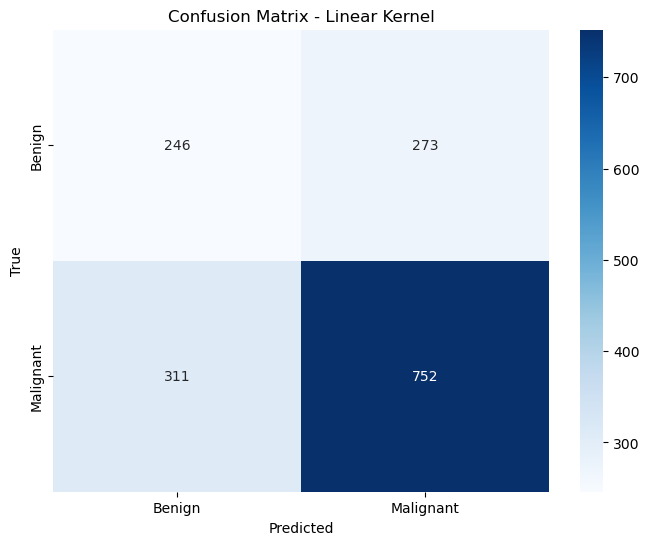

In [34]:
# Function to plot confusion matrix using seaborn
def plot_confusion_matrix(cm, labels):
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=labels, yticklabels=labels)
    plt.title("Confusion Matrix - Linear Kernel")
    plt.xlabel("Predicted")
    plt.ylabel("True")
    plt.show()

# Plot Confusion Matrix for Linear Kernel
plot_confusion_matrix(cm_linear, labels=['Benign', 'Malignant'])

## Polynomial Kernel Support Vector Machine (SVM)

In [35]:
# Polynomial Kernel
svm_poly = SVC(kernel='poly', degree=3, random_state=42)
svm_poly.fit(X_train_scaled, y_train)
y_pred_poly = svm_poly.predict(X_test_scaled)


In [36]:
accuracy_poly = accuracy_score(y_test, y_pred_poly)
print("\nPolynomial Kernel:")
print(f"Accuracy: {accuracy_poly*100:.2f}%")



Polynomial Kernel:
Accuracy: 69.15%


## Evaluation Measures

In [37]:
# Precision
precision_poly = precision_score(y_test, y_pred_poly)
print(f"Precision: {precision_poly:.2f}")

# Recall
recall_poly = recall_score(y_test, y_pred_poly)
print(f"Recall: {recall_poly:.2f}")

# F1-score
f1_poly = f1_score(y_test, y_pred_poly)
print(f"F1 Score: {f1_poly:.2f}")

Precision: 0.69
Recall: 0.98
F1 Score: 0.81


In [38]:
cm_poly = confusion_matrix(y_test, y_pred_poly)

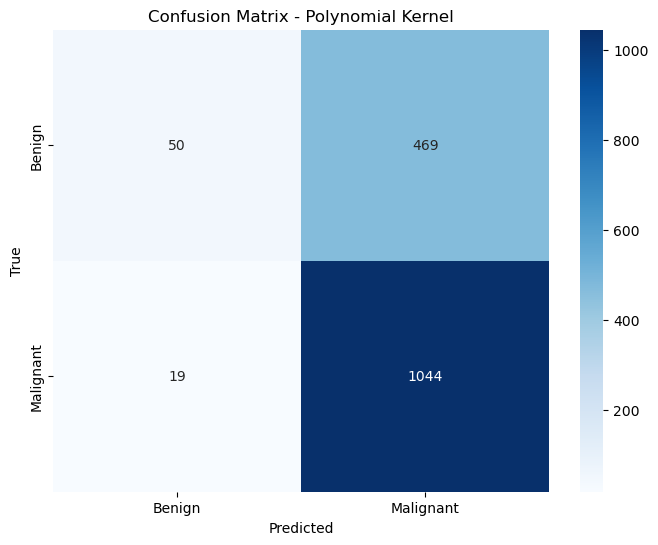

In [39]:
# Function to plot confusion matrix using seaborn
def plot_confusion_matrix(cm, labels):
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=labels, yticklabels=labels)
    plt.title("Confusion Matrix - Polynomial Kernel")
    plt.xlabel("Predicted")
    plt.ylabel("True")
    plt.show()

# Plot Confusion Matrix for Polynomial Kernel
plot_confusion_matrix(cm_poly, labels=['Benign', 'Malignant'])

## Radial Bais Function Support Vector Machine (SVM)

In [40]:
# RBF Kernel
svm_rbf = SVC(kernel='rbf', random_state=42)
svm_rbf.fit(X_train_scaled, y_train)
y_pred_rbf = svm_rbf.predict(X_test_scaled)


In [41]:
accuracy_rbf = accuracy_score(y_test, y_pred_rbf)
print("\nRBF Kernel:")
print(f"Accuracy: {accuracy_rbf*100:.2f}%")



RBF Kernel:
Accuracy: 71.93%


## Evaluation Measures

In [42]:
# Precision
precision_rbf = precision_score(y_test, y_pred_rbf)
print(f"Precision: {precision_rbf:.2f}")

# Recall
recall_rbf = recall_score(y_test, y_pred_rbf)
print(f"Recall: {recall_rbf:.2f}")

# F1-score
f1_rbf = f1_score(y_test, y_pred_rbf)
print(f"F1 Score: {f1_rbf:.2f}")

Precision: 0.72
Recall: 0.96
F1 Score: 0.82


In [43]:
cm_rbf = confusion_matrix(y_test, y_pred_rbf)

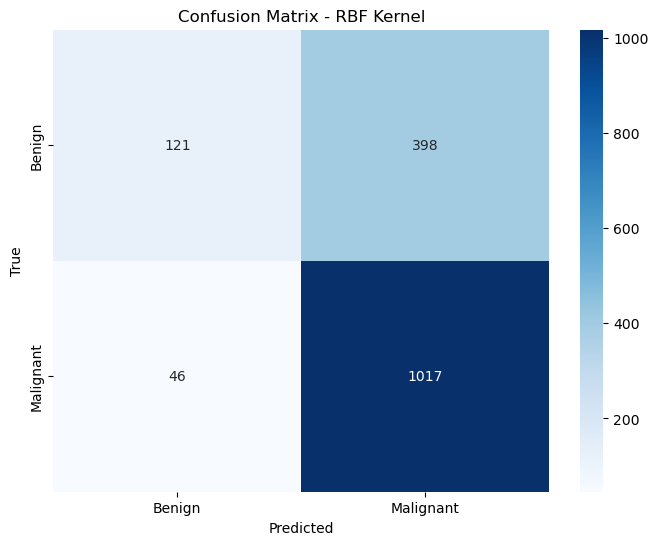

In [44]:
# Function to plot confusion matrix using seaborn
def plot_confusion_matrix(cm, labels):
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=labels, yticklabels=labels)
    plt.title("Confusion Matrix - RBF Kernel")
    plt.xlabel("Predicted")
    plt.ylabel("True")
    plt.show()

# Plot Confusion Matrix for RBF Kernel
plot_confusion_matrix(cm_rbf, labels=['Benign', 'Malignant'])

## Sigmoid Kernel Support Vector Machine (SVM)

In [45]:
# Sigmoid Kernel
svm_sigmoid = SVC(kernel='sigmoid', random_state=42)
svm_sigmoid.fit(X_train_scaled, y_train)
y_pred_sigmoid = svm_sigmoid.predict(X_test_scaled)


In [46]:
accuracy_sigmoid = accuracy_score(y_test, y_pred_sigmoid)
print("\nSigmoid Kernel:")
print(f"Accuracy: {accuracy_sigmoid*100:.2f}%")



Sigmoid Kernel:
Accuracy: 64.16%


## Evaluation Measures

In [47]:
cm_sigmoid = confusion_matrix(y_test, y_pred_sigmoid)

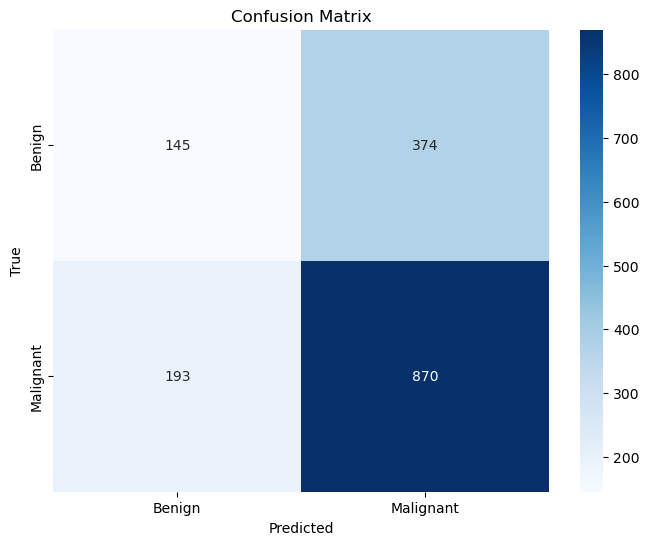

In [48]:
# Function to plot confusion matrix using seaborn
def plot_confusion_matrix(cm, labels):
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=labels, yticklabels=labels)
    plt.title("Confusion Matrix")
    plt.xlabel("Predicted")
    plt.ylabel("True")
    plt.show()

# Plot Confusion Matrix for Sigmoid Kernel
plot_confusion_matrix(cm_sigmoid, labels=['Benign', 'Malignant'])

In [49]:
# Precision
precision_sigmoid = precision_score(y_test, y_pred_sigmoid)
print(f"Precision: {precision_sigmoid:.2f}")

# Recall
recall_sigmoid = recall_score(y_test, y_pred_sigmoid)
print(f"Recall: {recall_sigmoid:.2f}")

# F1-score
f1_sigmoid = f1_score(y_test, y_pred_sigmoid)
print(f"F1 Score: {f1_sigmoid:.2f}")

Precision: 0.70
Recall: 0.82
F1 Score: 0.75


Choosing the RBF (Radial Basis Function) kernel based on a higher accuracy.The RBF kernel is a versatile choice for SVMs, and it tends to perform well across a variety of problems.